# Привет и добро пожаловать на Yet Another Data Challenge! 
В этом ноутбуке  - несколько полезных tips&tricks, которые помогут вам добиться выдающихся и фантастических результатов в этом контесте.  

Основные данные контеста: <a href="https://storage.yandexcloud.net/hackathon-2020/trainset.zip/">данные для обучения</a>,
<a href="https://storage.yandexcloud.net/hackathon-2020/trainset.zip">тестовые данные</a>. Как их лучше всего загрузить -- см. ниже

В тестовых данных -- первые восемь тактов разных мелодий, ваша задача -- предложить следующие восемь тактов для каждого отрывка так, чтобы получилась прекрасная мелодия, которая понравится нашим экспертам. 
Когда вы будете готовы, воспользуйтесь командой отправки данных на оценку и дождитесь результата. 

Удачи! 

In [869]:
#!XL
3+2

5

# Импортируем необходимые библиотеки

In [41]:
#!XL
from midi2audio import FluidSynth
import music21
from pathlib import Path
import requests
import shutil
from string import ascii_letters
import subprocess
from tqdm import tqdm
from typing import List
import zipfile
from IPython.display import Audio

In [3]:
#!XL
from typing import List
from pathlib import Path

In [4]:
#!XL
import warnings
warnings.filterwarnings("ignore")

# Загружаем данные 

In [4]:
#!M
# sound_font_zip = download_file('https://storage.yandexcloud.net/hackathon-2020/GeneralUser%20GS%201.471.zip', local_filename='GeneralUser_GS_1.471.zip')
# unzip(sound_font_zip)

In [5]:
#!M
# trainset_path = download_file('https://storage.yandexcloud.net/hackathon-2020/trainset.zip', local_filename='trainset.zip')
# unzip(trainset_path)

In [6]:
#!M
# testset_path = download_file('https://storage.yandexcloud.net/hackathon-2020/testset.zip', local_filename='testset.zip')
# unzip(testset_path)

In [7]:
#!M
# Path('predict_abc').mkdir(exist_ok=True)
# Path('predict_midi').mkdir(exist_ok=True)
# Path('tmp').mkdir(exist_ok=True)

In [608]:
#!XL
train = collect_children(Path('trainset/'))
test = collect_children(Path('testset/'))

0it [00:00, ?it/s]
0it [00:00, ?it/s]
1it [00:33, 33.25s/it]
45it [00:33, 23.28s/it]
99it [00:33, 16.29s/it]
153it [00:33, 11.41s/it]
187it [00:33,  7.99s/it]
247it [00:33,  5.59s/it]
296it [00:34,  3.91s/it]
353it [00:34,  2.74s/it]
411it [00:34,  1.92s/it]
457it [00:34,  1.34s/it]
519it [00:34,  1.06it/s]
569it [00:34,  1.51it/s]
640it [00:34,  2.16it/s]
694it [00:34,  3.08it/s]
745it [00:35,  4.39it/s]
803it [00:35,  6.25it/s]
853it [00:35,  8.78it/s]
912it [00:35, 12.46it/s]
972it [00:35, 17.64it/s]
1022it [00:35, 24.77it/s]
1082it [00:35, 34.77it/s]
1147it [00:36, 46.99it/s]
1219it [00:36, 65.29it/s]
1281it [00:36, 89.23it/s]
1356it [00:36, 121.22it/s]
1426it [00:36, 161.09it/s]
1499it [00:36, 210.15it/s]
1574it [00:36, 267.77it/s]
1643it [00:36, 323.52it/s]
1715it [00:36, 387.01it/s]
1786it [00:37, 447.27it/s]
1856it [00:37, 500.27it/s]
1936it [00:37, 562.42it/s]
2025it [00:37, 630.99it/s]
2114it [00:37, 690.04it/s]
2195it [00:37, 695.82it/s]
2278it [00:37, 730.51it/s]
2358it [00

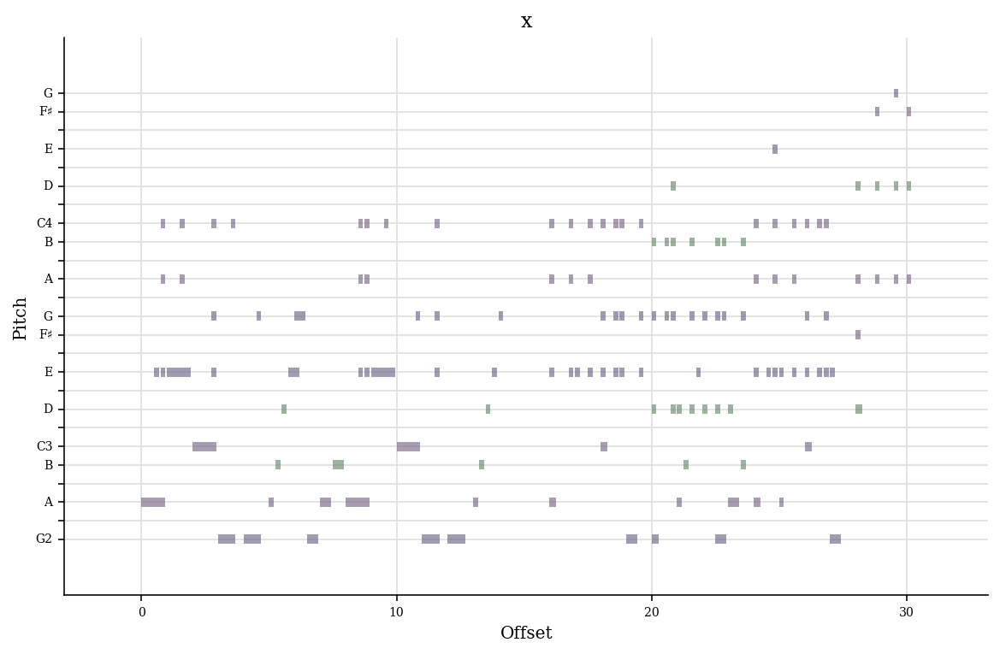

In [314]:
#!M
plot_pianoroll(test[100], 'x')
player(test[100])

# Строим модель

In [387]:
#!M
class MyBaselineModel(object):
    def __init__(self):
        self.dst_abc_dir = Path('predict_abc')
        self.dst_midi_dir = Path('predict_midi')
    
    def fit(self, X: List[Path]):
        pass
    
    def predict(self, X: List[Path]) -> List[Path]:
        res = []
        for i in tqdm(range(len(X))):
            res.append(self._predict(X[i]))
        return res
        
    def _predict(self, x: Path) -> Path:
        # read the input .abc file
        header, bars = read_abc(x)
        
        # a sophisticated machine learning algorithm that predicts next 8 bars of music comes here
        predicted_bars = bars + bars # [6:] + bars[4:6] + bars[4:6] + bars[6:]
        assert len(predicted_bars) == 16, f'Prediction must be of 16 bars, but got {len(predicted_bars)} bars'
        assert predicted_bars[:8] == bars, 'First 8 bars of the result must be the same as in query'
        
        # prepare the resulting files
        result_abc_file = self.dst_abc_dir / f'{x.stem}.abc'
        result_mid_file = self.dst_midi_dir / f'{x.stem}.mid'
        
        # save to .abc
        with open(result_abc_file, 'w') as output_file:
            output_file.write('\n'.join(header + predicted_bars))
        
        # convert .abc to .mid
        abc2midi(result_abc_file, result_mid_file)
        return result_mid_file

In [388]:
#!M
model = MyBaselineModel()
# model.fit(train)

# Применяем модель

In [389]:
#!M
z = model.predict(test)

100%|██████████| 10200/10200 [04:49<00:00, 35.18it/s]


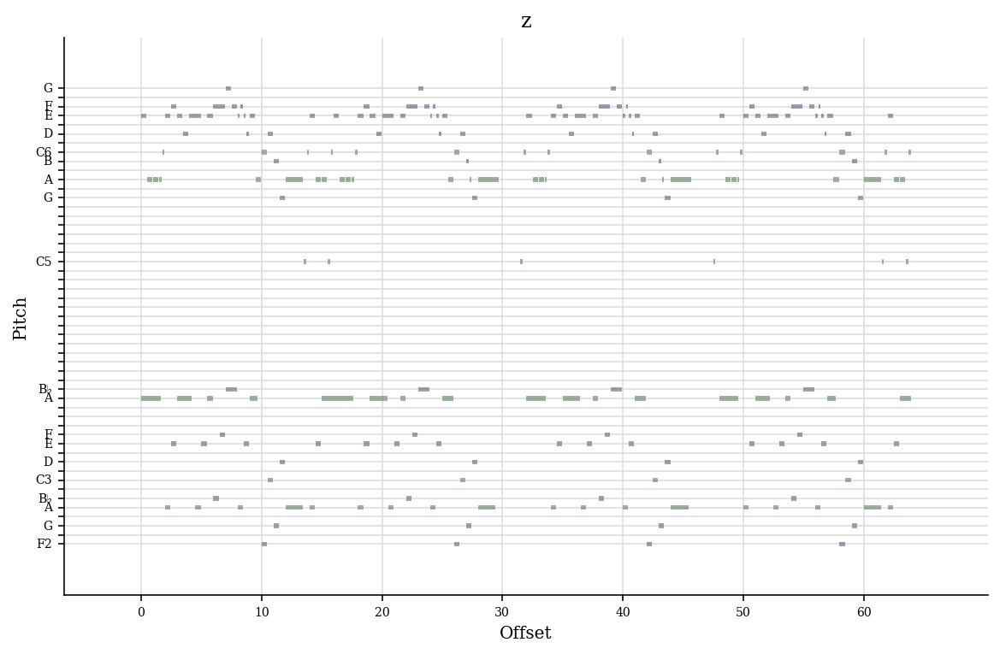

In [25]:
#!M
plot_pianoroll(z[0], 'z')
player(z[0])

# Отправляем данные на оценку

In [390]:
#!nirvana
yadc_submit_results --result-dir ./predict_midi --user pansf

[Step 1/2] Submitting audio files from ./predict_midi ...
[Step 2/2] Running estimation process ...

 100.0% [==================================================>]

Score of your submission: 0.480000
You can see the full leader board at https://datalens.yandex/k9w3qh5luixef


# Вспомогательные функции (уже загружены в состояние)

In [5]:
#!M
def download_file(url: str, local_filename: str = None) -> str:
    local_filename = local_filename or url.split('/')[-1]
    with requests.get(url, stream=True) as r:
        with open(local_filename, 'wb') as f:
            shutil.copyfileobj(r.raw, f)
    return local_filename

In [6]:
#!M
def unzip(zip_filename: str, dst_dir: str = './'):
    with zipfile.ZipFile(zip_filename, 'r') as zf:
        for entry in tqdm(zf.infolist(), desc='Extracting '):
            try:
                zf.extract(entry, dst_dir)
            except zipfile.error as e:
                print(e)
                pass

In [7]:
#!M
def collect_children(path: Path) -> List[Path]:
    if path.is_file():
        return [path]
    else:
        result = []
        for child in tqdm(path.iterdir()):
            if child.is_file():
                result.append(child)
            elif child.is_dir():
                result.extend(collect_children(child))
        return result

In [43]:
#!XL
def read_abc(path: Path) -> List[List[str]]:
    header = []
    bars = []
    is_header = True
    with open(path, 'r') as input_file:
        for line in input_file:
            line = line.strip()
            if is_header and (not line or line.startswith('%') or (line[0] in ascii_letters and line[1] == ':')):
                header.append(line)
            else:
                is_header = False
                bars.append(line)
    return header, bars

In [45]:
#!XL
def abc2midi(abc_file: Path, midi_file: Path) -> None:
    command = f'abc2midi {abc_file} -o {midi_file}'
    subprocess.run(command.split(), timeout=2, check=True)

In [10]:
#!M
def plot_pianoroll(path: Path, title: str = '') -> None:
    ext = path.suffix
    midi_file = path if ext == '.mid' else Path('tmp') / f'{path.stem}.mid'
    if ext == '.abc' and not midi_file.is_file():
        abc2midi(path, midi_file)
    if midi_file.is_file():
        music21.converter.parse(midi_file).plot('pianoroll', title=title)

In [11]:
#!M
def player(path: Path):
    ext = path.suffix
    wav_file = path if ext == '.wav' else Path('tmp') / f'{path.stem}.wav'
    if ext == '.mid':
        midi2wav(path, wav_file)
    elif ext == '.abc':
        midi_file = Path('tmp') / f'{path.stem}.mid'
        abc2midi(path, midi_file)
        midi2wav(midi_file, wav_file)
    if wav_file.is_file():
        return Audio(wav_file)
    else:
        print(f'could not convert {path} to .wav')
    return None

In [12]:
#!M
def midi2wav(midi_file: Path, wav_file: Path) -> None:
    FluidSynth(sound_font='GeneralUser GS 1.471/GeneralUser GS v1.471.sf2', sample_rate=8000).midi_to_audio(midi_file, wav_file)

In [46]:
#!XL
def midi2wav(midi_file: Path, wav_file: Path) -> None:
    FluidSynth(sound_font='GeneralUser GS 1.471/GeneralUser GS v1.471.sf2', sample_rate=8000).midi_to_audio(midi_file, wav_file)

In [ ]:
#!M


In [ ]:
#!M


In [ ]:
#!M


чепушневый w2v

In [331]:
#!M
from gensim.test.utils import common_texts
from gensim.models import Word2Vec

In [333]:
#!M
res = []
d = {}
for i in tqdm(range(len(test))):
    try:
        header, bars = read_abc(test[i])
        res.append(bars)
        for el in bars:
            d[el] = test[i]
    except:
        continue

100%|██████████| 10200/10200 [00:46<00:00, 219.24it/s]


In [335]:
#!M
d['[F,2-B,,2-][F,/2B,,/2-]B,,/2-[F,/2-B,,/2]F,/2[F,4^A,,4]|']

PosixPath('testset/abc/9111.abc')

In [336]:
#!M
model = Word2Vec(sentences=res, size=50, window=5, min_count=1, workers=4)

In [364]:
#!M
player(test[142])

In [267]:
#!M
# new_bars = []
# header, bars = read_abc(test[142])
# for el in bars:
#     new_bars.append(model.similar_by_word(el)[0][0])

# result_abc_file = Path('draft_test142.abc')
# result_mid_file = Path('draft_test142.mid')
# bars = bars + new_bars

# with open(result_abc_file, 'w') as output_file:
#     output_file.write('\n'.join(header + bars))

# abc2midi(result_abc_file, result_mid_file)

/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:4: DeprecationWarning: Call to deprecated `similar_by_word` (Method will be removed in 4.0.0, use self.wv.similar_by_word() instead).
  import json
/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:588: UserWarning: The following variables cannot be serialized: output_file
  warnings.warn(message)


In [22]:
#!M
# player(result_mid_file)

In [339]:
#!M
class MyBaselineModel2(object):
    def __init__(self):
        self.dst_abc_dir = Path('predict_abc')
        self.dst_midi_dir = Path('predict_midi')
    
    def fit(self, X: List[Path]):
        pass
    
    def predict(self, X: List[Path]) -> List[Path]:
        res = []
        for i in tqdm(range(len(X))):
            res.append(self._predict(X[i]))
        return res
        
    def _predict(self, x: Path) -> Path:
        # read the input .abc file
        header, bars = read_abc(x)

#         try:
#             new_bars = []
#             for el in bars:
#                 new_bars.append(model.similar_by_word(el)[0][0])
#         except:
#             new_bars = bars

        p = d[model.similar_by_word(bars[-1])[0][0]]
        _, new_bars = read_abc(p)
        
        # a sophisticated machine learning algorithm that predicts next 8 bars of music comes here
        predicted_bars = bars + new_bars
        assert len(predicted_bars) == 16, f'Prediction must be of 16 bars, but got {len(predicted_bars)} bars'
        assert predicted_bars[:8] == bars, 'First 8 bars of the result must be the same as in query'
        
        # prepare the resulting files
        result_abc_file = self.dst_abc_dir / f'{x.stem}.abc'
        result_mid_file = self.dst_midi_dir / f'{x.stem}.mid'
        
        # save to .abc
        with open(result_abc_file, 'w') as output_file:
            output_file.write('\n'.join(header + predicted_bars))
        
        # convert .abc to .mid
#         print(result_abc_file, result_mid_file)
        abc2midi(result_abc_file, result_mid_file)
        return result_mid_file

In [340]:
#!M
mdl = MyBaselineModel2()

In [341]:
#!M
z = mdl.predict(test)

100%|██████████| 10200/10200 [05:50<00:00, 29.08it/s]


In [33]:
#!M
player(z[142])

In [347]:
#!M

In [35]:
#!M
player(z[144])

In [36]:
#!M
player(test[144])

In [354]:
#!nirvana
yadc_submit_results --result-dir ./predict_midi --user pansf

[Step 1/2] Submitting audio files from ./predict_midi ...
[Step 2/2] Running estimation process ...

 100.0% [==================================================>]

Score of your submission: 0.370000
You can see the full leader board at https://datalens.yandex/k9w3qh5luixef


In [ ]:
#!M


In [ ]:
#!M


In [ ]:
#!M


In [ ]:
#!M


Новый

In [406]:
#!XL
%pip install music21

     |████████████████████████████████| 19.2 MB 225 kB/s 
     |████████████████████████████████| 178 kB 62.9 MB/s 
     |████████████████████████████████| 302 kB 58.8 MB/s 
     |████████████████████████████████| 45 kB 4.3 MB/s 
  Created wheel for music21: filename=music21-6.3.0-py3-none-any.whl size=21885685 sha256=f19d1762bdd10ae0368df30d41093ce3392a43e2632d15919f7c5f2af3b410b3
  Stored in directory: /root/.cache/pip/wheels/6a/d0/ae/11a9d9a4052ed2094afc14daf1f5a39569890dedb95be40612
Successfully built music21
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
requests 2.22.0 requires chardet<3.1.0,>=3.0.2, but you have chardet 4.0.0 which is incompatible.
You should consider upgrading via the '/usr/bin/python3.7 -m pip install --upgrade pip' command.


In [564]:
#!XL
from music21 import stream
from music21 import roman
from music21 import converter, corpus, instrument, midi, note, chord, pitch

In [565]:
#!XL
def note_count(measure, count_dict):
    bass_note = None
    for chord in measure.recurse().getElementsByClass('Chord'):
        # All notes have the same length of its chord parent.
        note_length = chord.quarterLength
        for note in chord.pitches:          
            # If note is "C5", note.name is "C". We use "C5"
            # style to be able to detect more precise inversions.
            note_name = str(note) 
            if (bass_note is None or bass_note.ps > note.ps):
                bass_note = note
                
            if note_name in count_dict:
                count_dict[note_name] += note_length
            else:
                count_dict[note_name] = note_length
        
    return bass_note
                
def simplify_roman_name(roman_numeral):
    # Chords can get nasty names as "bII#86#6#5",
    # in this method we try to simplify names, even if it ends in
    # a different chord to reduce the chord vocabulary and display
    # chord function clearer.
    ret = roman_numeral.romanNumeral
    inversion_name = None
    inversion = roman_numeral.inversion()
    
    # Checking valid inversions.
    if ((roman_numeral.isTriad() and inversion < 3) or
            (inversion < 4 and
                 (roman_numeral.seventh is not None or roman_numeral.isSeventh()))):
        inversion_name = roman_numeral.inversionName()
        
    if (inversion_name is not None):
        ret = ret + str(inversion_name)
        
    elif (roman_numeral.isDominantSeventh()): ret = ret + "M7"
    elif (roman_numeral.isDiminishedSeventh()): ret = ret + "o7"
    return ret
                
def harmonic_reduction(midi_file):
    ret = []
    temp_midi = stream.Score()
    temp_midi_chords = midi_file.chordify()
    temp_midi.insert(0, temp_midi_chords)    
    music_key = temp_midi.analyze('key')
    max_notes_per_chord = 4   
    for m in temp_midi_chords.measures(0, None): # None = get all measures.
        if (type(m) != stream.Measure):
            continue
        
        # Here we count all notes length in each measure,
        # get the most frequent ones and try to create a chord with them.
        count_dict = dict()
        bass_note = note_count(m, count_dict)
        if (len(count_dict) < 1):
            ret.append("-") # Empty measure
            continue
        
        sorted_items = sorted(count_dict.items(), key=lambda x:x[1])
        sorted_notes = [item[0] for item in sorted_items[-max_notes_per_chord:]]
        measure_chord = chord.Chord(sorted_notes)
        
        # Convert the chord to the functional roman representation
        # to make its information independent of the music key.
        roman_numeral = roman.romanNumeralFromChord(measure_chord, music_key)
        ret.append(simplify_roman_name(roman_numeral))
        
    return ret

def open_midi(midi_path, remove_drums):
    # There is an one-line method to read MIDIs
    # but to remove the drums we need to manipulate some
    # low level MIDI events.
    mf = midi.MidiFile()
    mf.open(midi_path)
    mf.read()
    mf.close()
    if (remove_drums):
        for i in range(len(mf.tracks)):
            mf.tracks[i].events = [ev for ev in mf.tracks[i].events if ev.channel != 10]          

    return midi.translate.midiFileToStream(mf)

In [799]:
#!XL
base_midi = open_midi('draft_test142.mid', True)
base_midi

<music21.stream.Score 0x7f92aca9e550>

In [567]:
#!XL
import os
testset_midi = os.listdir('testset_midi')

In [568]:
#!XL
testset_midi[0:10]

['423.mid',
 '1413.mid',
 '6923.mid',
 '6270.mid',
 '8599.mid',
 '3042.mid',
 '4853.mid',
 '5152.mid',
 '7184.mid',
 '7496.mid']

In [800]:
#!XL
harmonic_reduction(base_midi)[0:10]

['iii', 'ii42', 'iii', 'ii65', 'iii', 'ii65', 'iii', 'ii65', 'ii65', 'vi53']

In [572]:
#!XL
from multiprocessing import Pool # Use this when CPU-intensive functions are the problem.
import pandas as pd

def get_file_name(link):
    filename = link.split('/')[::-1][0]
    return filename

# Go get a coffee, this cell takes hours to run...
def process_single_file(midi_param):
    try:
        game_name = midi_param[0]
        midi_path = midi_param[1]
        midi_name = get_file_name(midi_path)
        midi = open_midi(midi_path, True)
        return (
            midi.analyze('key'),
            game_name,
            harmonic_reduction(midi),
            midi_name)
    except Exception as e:
        print("Error on {0}".format(midi_name))
        print(e)
        return None

def create_midi_dataframe():
    key_signature_column = []
    game_name_column = []
    harmonic_reduction_column = []
    midi_name_column = []
    pool = Pool(8)
    midi_params = []

    folder_path = 'testset_midi'
    for midi_name in tqdm(os.listdir(folder_path)):
        midi_params.append(('key', concat_path(folder_path, midi_name)))

    results = tqdm(pool.map(process_single_file, midi_params))
    for result in tqdm(results):
        if (result is None):
            continue
            
        key_signature_column.append(result[0])
        game_name_column.append(result[1])
        harmonic_reduction_column.append(result[2])
        midi_name_column.append(result[3])
    
    d = {'midi_name': midi_name_column,
         'game_name': game_name_column,
         'key_signature' : key_signature_column,
         'harmonic_reduction': harmonic_reduction_column}
    return pd.DataFrame(data=d)

def concat_path(path, child):
    return path + "/" + child

In [801]:
#!XL
# sonic_df = create_midi_dataframe()
sonic_df = pd.read_csv('out_df.csv', sep=';', usecols=['midi_name','game_name','key_signature','harmonic_reduction'])
sonic_df.tail()

,midi_name,game_name,key_signature,harmonic_reduction
10195,2371.mid,key,C# major,"['v65', 'i', 'i', 'i', 'i43', 'i', 'i', 'i6']"
10196,4446.mid,key,e minor,"['III7', 'ii65', 'III7', 'i', 'III53', 'III7',..."
10197,6285.mid,key,f# minor,"['i', 'i42', 'III', 'iii65', 'i42', 'i42', 'II..."
10198,1838.mid,key,B major,"['ii', '-i', '-iv', '-iv', 'IV53', '-i', '-iv'..."
10199,2926.mid,key,c minor,"['iii42', 'i7', 'iii42', 'i7', 'iii42', 'i7', ..."


In [802]:
#!XL
sonic_df['harmonic_reduction'] = [x.replace("'", "").replace(" ", "").strip('[]').split(',') for x in sonic_df['harmonic_reduction']]

In [450]:
# #!XL
# for i in range(10):
#     header, bars = read_abc(test[i])
#     print(header, test[i])

['X:1', 'T:', 'M:4/4', 'L:1/8', 'Q:1/4=120', 'K:C', '%0sharps', '%%MIDI program 0', 'V:1', '%%MIDI program 0'] testset/abc/3474.abc
['X:1', 'T:', 'M:4/4', 'L:1/8', 'Q:1/4=60', 'K:F#', '%6sharps', '%%MIDI program 0', '%%MIDI program 0', 'V:1', '%%MIDI program 24'] testset/abc/9111.abc
['X:1', 'T:', 'M:4/4', 'L:1/8', 'Q:1/4=120', 'K:C', '%0sharps', '%%MIDI program 0', '%%MIDI program 0', 'V:1', '%%MIDI program 24'] testset/abc/4206.abc
['X:1', 'T:', 'M:4/4', 'L:1/8', 'Q:1/4=100', 'K:F', '%1flats', '%%MIDI program 0', 'V:1', '%%MIDI program 0'] testset/abc/7709.abc
['X:1', 'T:', 'M:4/4', 'L:1/8', 'Q:1/4=70', 'K:Bb', '%2flats', '%%MIDI program 0', 'V:1', '%%MIDI program 0'] testset/abc/2948.abc
['X:1', 'T:', 'M:4/4', 'L:1/8', 'Q:1/4=121', 'K:Bb', '%2flats', '%%MIDI program 0', 'V:1', '%%MIDI program 0'] testset/abc/3133.abc
['X:1', 'T:', 'M:4/4', 'L:1/8', 'Q:1/4=169', 'K:G', '%1sharps', '%%MIDI program 0', '%%MIDI program 0', 'V:1', '%%MIDI program 24'] testset/abc/9363.abc
['X:1', 'T:', '

In [803]:
#!XL
sonic_df['Q'] = -1
sonic_df['K'] = ''
sonic_df['%'] = ''
for index, row in tqdm(sonic_df.iterrows()):
    name = row['midi_name'].split('.')[0]
    header = []
    bars = []
    is_header = True
    path = 'testset/abc/' + name + '.abc'
    with open(path, 'r') as input_file:
        for line in input_file:
            line = line.strip()
            if is_header and (not line or line.startswith('%') or (line[0] in ascii_letters and line[1] == ':')):
                header.append(line)
            else:
                is_header = False
                bars.append(line)
    Q = int(header[4].split('=')[-1])
    K = header[5].split(':')[-1]
    perc = header[6]
    sonic_df.loc[index, ['Q', 'K', '%']] = [Q, K, perc]
sonic_df.tail()

10200it [01:58, 86.16it/s] 
/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:619: UserWarning: The following variables cannot be serialized: input_file
  warnings.warn(message)


,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
10195,2371.mid,key,C# major,"[v65, i, i, i, i43, i, i, i6]",68,B,%5sharps
10196,4446.mid,key,e minor,"[III7, ii65, III7, i, III53, III7, III7, i]",86,D,%2sharps
10197,6285.mid,key,f# minor,"[i, i42, III, iii65, i42, i42, III, i]",175,E,%4sharps
10198,1838.mid,key,B major,"[ii, -i, -iv, -iv, IV53, -i, -iv, -iv]",120,B,%5sharps
10199,2926.mid,key,c minor,"[iii42, i7, iii42, i7, iii42, i7, iii42, i7]",110,Bb,%2flats


,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
0,423.mid,key,A major,"[vii43, IV64, iii6, I53, I53, I53, I53, I53]",107,A,%3sharps
1,1413.mid,key,A- major,"[V, iii42, #iii42, iii64, #vii42, #iii43, iii4...",100,Ab,%4flats
2,6923.mid,key,c minor,"[i53, v7, III, v43, i53, v7, III, v43]",120,Eb,%3flats
3,6270.mid,key,e minor,"[i, i, iv, iv, v, v, iv7, ii65]",225,E,%4sharps
4,8599.mid,key,F# major,"[v, --vii64, -i, -iv, v, --vii64, -i, v42]",133,F#,%6sharps


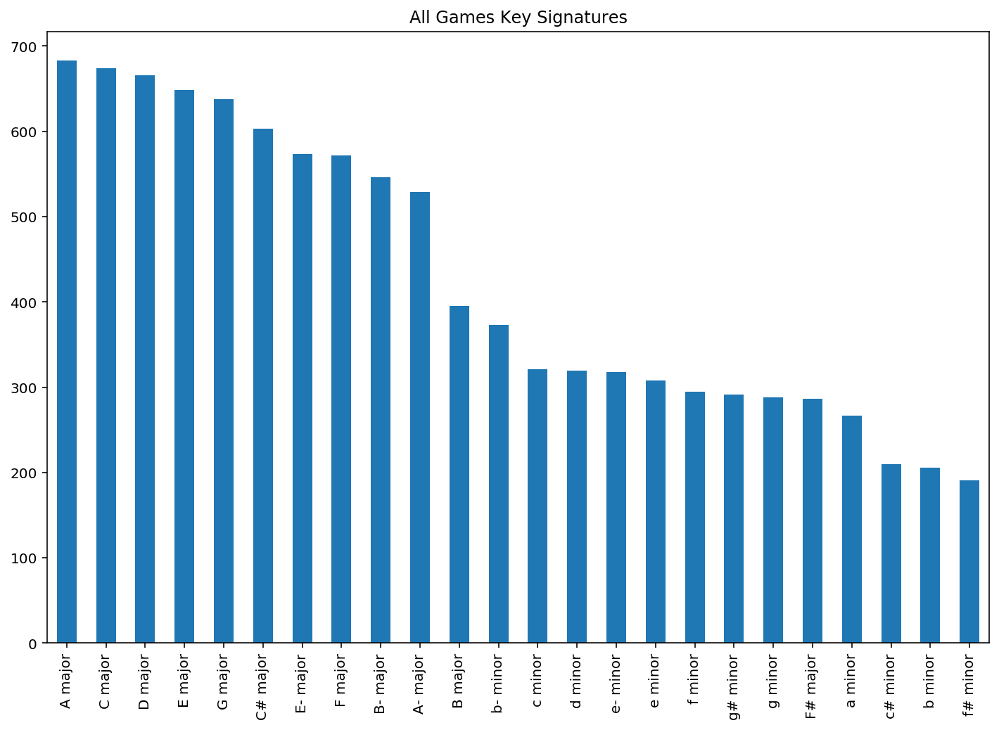

In [804]:
#!XL
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
fig, axes = plt.subplots(nrows=1, ncols = 1, figsize=(12, 8))
fig.subplots_adjust(hspace=0.4, wspace=0.3)
title = "All Games Key Signatures"
sonic_df["key_signature"].value_counts().plot(kind='bar', title = title)
sonic_df.head()

In [805]:
#!XL
import gensim, logging
# logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)
 
model = gensim.models.Word2Vec(sonic_df["harmonic_reduction"], min_count=2, window=4)

In [806]:
#!XL
def get_related_chords(token, topn=3):
    print("Similar chords with " + token)
    for word, similarity in model.wv.most_similar(positive=[token], topn=topn):
        print (word, round(similarity, 3))

def get_chord_similarity(chordA, chordB):
    print("Similarity between {0} and {1}: {2}".format(
        chordA, chordB, model.wv.similarity(chordA, chordB)))
    
print("List of chords found:")
print(model.wv.vocab.keys())
print("Number of chords considered by model: {0}".format(len(model.wv.vocab)))

get_related_chords('I')
get_related_chords('iv')
get_related_chords('V')

# The first one should be smaller since "i" and "ii" chord doesn't share notes,
# different from "IV" and "vi" which share 2 notes.
get_chord_similarity("I", "ii") 
get_chord_similarity("IV", "vi")

# This one should be bigger because they are "enharmonic".
get_chord_similarity("-i", "vii")

List of chords found:
dict_keys(['vii43', 'IV64', 'iii6', 'I53', 'V', 'iii42', '#iii42', 'iii64', '#vii42', '#iii43', 'iii43', 'V53', 'i53', 'v7', 'III', 'v43', 'i', 'iv', 'v', 'iv7', 'ii65', '--vii64', '-i', '-iv', 'v42', 'I6', '-VII6', 'IV53', 'V64', '#iii', 'v53', 'i64', 'III6', '-VII64', 'iv42', '-VII', 'ii', '--vii', 'iii', '-vii', 'i65', 'vi', 'IV', 'ii42', 'V6', 'vii', 'I', 'III53', '-VII53', 'iii65', 'i43', 'I43', 'I64', 'II53', 'vii65', '#vi', '-VI', 'vi43', '#iii7', 'V7', 'ii7', '#ii', 'IV43', 'V43', 'vii53', 'iv64', '--iii6', 'vi7', '-iv64', 'ii53', '-iii', 'V65', '#v65', 'i7', '#vi43', 'IV7', 'I65', 'vi53', 'III42', 'ii43', '##iii42', '##iii', '-vi', '--vi', '--vi6', 'iii7', 'II64', 'VI', '#vi42', '-iv6', '#iii65', '#vii65', '#vi7', 'IV42', '--iii', '-i6', '#v', '#ii42', 'vii6', 'i6', 'vi42', 'iii53', 'IV6', '-ii7', 'ii6', '-ii', 'i42', 'III7', '-i64', 'vi6', 'II6', '#iv65', 'vi64', 'V42', '-II6', 'I42', '-IV', '--VI53', 'iv43', '-VI53', '-II53', '-VI7', 'iv53', '#iv6', '#i

In [807]:
#!XL
import numpy as np
def vectorize_harmony(model, harmonic_reduction):
    # Gets the model vector values for each chord from the reduction.
    word_vecs = []
    for word in harmonic_reduction:
        try:
            vec = model[word]
            word_vecs.append(vec)
        except KeyError:
            # Ignore, if the word doesn't exist in the vocabulary
            pass
    
    # Assuming that document vector is the mean of all the word vectors.
    return np.mean(word_vecs, axis=0)

def cosine_similarity(vecA, vecB):
    # Find the similarity between two vectors based on the dot product.
    csim = np.dot(vecA, vecB) / (np.linalg.norm(vecA) * np.linalg.norm(vecB))
    if np.isnan(np.sum(csim)):
        return 0
    
    return csim

In [808]:
#!XL
vectorize_harmony(model, sonic_df["harmonic_reduction"][0:1].values[0])
# sonic_df["harmonic_reduction"][0:1].values[0]

/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


array([-0.36752483, -0.18754551,  0.5899287 , -0.2640167 , -0.5139468 ,
       -0.16329548, -0.5964553 ,  0.17972988, -0.13990703, -0.31604674,
        0.38804924,  0.29293495, -0.2723874 ,  0.10519548,  0.36023024,
       -0.36106792, -0.6167177 , -0.18728383,  0.10981868,  0.33294445,
        0.279961  , -0.06116981,  0.16838741, -0.13110831, -0.41574946,
        0.29677248,  0.1442576 , -0.2469397 , -0.11426765,  0.07711171,
        0.02459335, -0.38539672,  0.06734283,  0.13689668,  0.45156646,
       -0.00521652, -0.2503418 ,  0.15545462, -0.32314056, -0.2557582 ,
       -0.34488207, -0.06611986,  0.24772078, -0.13353533, -0.815754  ,
        0.35412282, -0.28010878,  0.08453148, -0.28780526,  0.00311949,
       -0.16276495,  0.21871302, -0.38427705, -0.02941236, -0.32598296,
        0.00766922, -0.41063207,  0.00119049,  0.35617828,  0.41139907,
       -0.214874  , -0.05022643,  0.2061047 , -0.36823416, -0.08405513,
       -0.06926609,  0.03499211, -0.4856977 ,  0.5641642 ,  0.52

In [809]:
#!XL
a_ = vectorize_harmony(model, sonic_df["harmonic_reduction"][0:1].values[0])
b_ = vectorize_harmony(model, sonic_df["harmonic_reduction"][1:2].values[0])
cosine_similarity(a_, b_)

/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


0.6738239

In [810]:
#!XL
sonic_df.loc[(sonic_df.Q==120) & (sonic_df.K=='A')]

,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
66,96.mid,key,f# minor,"[i42, vii, iv, i53, i, -VII64, iv, i53]",120,A,%3sharps
326,23.mid,key,b minor,"[III43, III43, ii42, ii42, III43, III43, ii42,...",120,A,%3sharps
380,792.mid,key,e minor,"[i, ii42, ii42, ii, i, ii42, ii42, iv]",120,A,%3sharps
556,733.mid,key,E major,"[I53, I53, I53, I53, I53, I53, i, iii6]",120,A,%3sharps
579,530.mid,key,f# minor,"[i53, III53, -VII6, i53, i53, III53, -VII6, i53]",120,A,%3sharps
...,...,...,...,...,...,...,...
9950,832.mid,key,A major,"[I53, IV64, IV64, I53, V53, iv, I64, I53, i]",120,A,%3sharps
9988,4.mid,key,F major,"[v, v, i, v, v, II, #iv, #v]",120,A,%3sharps
10079,553.mid,key,b minor,"[v53, i42, i65, v53, i53, IV53, IV53, i53]",120,A,%3sharps
10130,718.mid,key,b minor,"[v, v, v, v, iv, ii, iv, i]",120,A,%3sharps


In [811]:
#!XL
# def calculate_similarity_aux(df, model, threshold=0.5):
#     out_df = df.copy()
#     out_df['continue'] = ''
#     out_df['sim_score'] = 0
#     all_names = df["midi_name"].values
#     for i, name in tqdm(enumerate(all_names)):
#         source_harmo = df[df["midi_name"] == name]["harmonic_reduction"].values[0]
#         source_vec = vectorize_harmony(model, source_harmo)    
#         results = []
#         results.append({
#                     'score' : 0,
#                     'name' : 'no'
#                 })
#         for n in all_names:
#             if name != n:
#                 target_harmo = df[df["midi_name"] == n]["harmonic_reduction"].values[0]
#                 if (len(target_harmo) == 0):
#                     continue

#                 target_vec = vectorize_harmony(model, target_harmo)       
#                 sim_score = cosine_similarity(source_vec, target_vec)
#     #             print(sim_score)
#                 if sim_score > threshold:
#                     results.append({
#                         'score' : sim_score,
#                         'name' : n
#                     })

#         # Sort results by score in desc order
#         results.sort(key=lambda k : k['score'] , reverse=True)
# #         print(results)
#         if results[0]['name'] == 'no':
#             out_df.loc[i, 'continue'] = name
#         else:
# #             print(results[0]['name'])
#             out_df.loc[i, ['continue', 'sim_score']] = [results[0]['name'], results[0]['score']]
            
#     return out_df


def calculate_similarity_aux(df, model, threshold=0.5):
    out_df = df.copy()
    out_df['continue'] = ''
    out_df['sim_score'] = 0
#     all_names = df["midi_name"].values
    for index, row in tqdm(out_df.iterrows()):
        name = row["midi_name"]
        source_harmo = row["harmonic_reduction"]
        source_vec = vectorize_harmony(model, source_harmo)    
        results = []
        key_signature = row['key_signature']
        Q = row["Q"]
        K = row["K"]
        perc = row["%"]
        results.append({
                    'score' : 0,
                    'name' : 'no'
                })
        for index2, row2 in df.loc[(df['key_signature']==key_signature) & (df.Q==Q) & (df.K==K) & (df['%']==perc)].iterrows():
            n = row2["midi_name"]
            if name != n:
                target_harmo = row2["harmonic_reduction"]
                if (len(target_harmo) == 0):
                    continue

                target_vec = vectorize_harmony(model, target_harmo)       
                sim_score = cosine_similarity(source_vec, target_vec)
    #             print(sim_score)
                if sim_score > threshold:
                    results.append({
                        'score' : sim_score,
                        'name' : n
                    })
#                 if sim_score >= 0.98:
#                     break

        # Sort results by score in desc order
        results.sort(key=lambda k : k['score'] , reverse=True)
#         print(len(results))
        if results[0]['name'] == 'no':
            out_df.loc[index, 'continue'] = name
        else:
#             print(results[0]['name'])
            out_df.loc[index, ['continue', 'sim_score']] = [results[0]['name'], results[0]['score']]
            
    return out_df

In [812]:
#!XL
out_df = calculate_similarity_aux(sonic_df, model, threshold=0.9)
# out_df.to_csv('out_df.csv', sep=';')
out_df.head()

0it [00:00, ?it/s]/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys
10200it [01:23, 121.96it/s]


,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%,continue,sim_score
0,423.mid,key,A major,"[vii43, IV64, iii6, I53, I53, I53, I53, I53]",107,A,%3sharps,89.mid,0.969240
1,1413.mid,key,A- major,"[V, iii42, #iii42, iii64, #vii42, #iii43, iii4...",100,Ab,%4flats,1180.mid,0.985678
2,6923.mid,key,c minor,"[i53, v7, III, v43, i53, v7, III, v43]",120,Eb,%3flats,7054.mid,0.968268
3,6270.mid,key,e minor,"[i, i, iv, iv, v, v, iv7, ii65]",225,E,%4sharps,6270.mid,0.000000
4,8599.mid,key,F# major,"[v, --vii64, -i, -iv, v, --vii64, -i, v42]",133,F#,%6sharps,8599.mid,0.000000


In [432]:
#!XL
# out_df_loaded = pd.read_csv('out_df.csv', sep=';')
# out_df_loaded.tail(20)

In [813]:
#!XL
def player2(path, p2): 
    wav_file = 'tmp/'+path.split('.')[0]+'.wav'
    midi2wav(p2+path, wav_file)
    return Audio(wav_file)

player2('6923.mid', 'testset_midi/')

In [587]:
#!XL
player2('7223.mid', 'testset_midi/')

In [814]:
#!XL
len(out_df.loc[out_df.sim_score>=0.9])

4352

In [494]:
#!XL
# Path('predict_midi_pairs').mkdir(exist_ok=True)

In [505]:
# !XL
# Path('predict_abc_pairs').mkdir(exist_ok=True)

! is disabled. For pip use '%pip ...'


In [498]:
#!XL
# %pip install git+https://github.com/vishnubob/python-midi@feature/python3

  Cloning https://github.com/vishnubob/python-midi (to revision feature/python3) to /tmp/pip-req-build-v37rjiin
  Created wheel for midi: filename=midi-0.2.3-cp37-cp37m-linux_x86_64.whl size=281071 sha256=7d50a4c0d06cfc81f4b5bb10ed7e608f7662cdb39d31331a7be645c0e302df93
  Stored in directory: /tmp/pip-ephem-wheel-cache-60fn8jw8/wheels/31/42/68/b7b99ce373ff4c2ef140f869eeb0b3c5297c64a2ac16b5dc88
Successfully built midi
You should consider upgrading via the '/usr/bin/python3.7 -m pip install --upgrade pip' command.


/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:588: UserWarning: The following variables cannot be serialized: input_file
  warnings.warn(message)


In [499]:
# #!XL
# import midi as pymidi

In [500]:
# #!XL
# for index, row in tqdm(out_df.iterrows()):
#     pattern1 = pymidi.read_midifile('testset_midi/'+row["midi_name"])
#     pattern2 = pymidi.read_midifile('testset_midi/'+row["continue"])
    
#     pattern = pymidi.Pattern()

#     for track in pattern1:
#         pattern.append(track)

#     for track in pattern2:
#         pattern.append(track)
        
#     pymidi.write_midifile('predict_midi_pairs/'+row["midi_name"], pattern)

10200it [02:59, 56.86it/s]


In [504]:
# #!XL
# player2('89.mid', 'predict_midi_pairs/')

In [816]:
#!XL

z = []

for index, row in tqdm(out_df.iterrows()):
    
    header1, bars1 = r_abc('testset/abc/'+row["midi_name"].split('.')[0]+'.abc')
    header2, bars2 = r_abc('testset/abc/'+row["continue"].split('.')[0]+'.abc')


    # a sophisticated machine learning algorithm that predicts next 8 bars of music comes here
    predicted_bars = bars1 + bars2
    assert len(predicted_bars) == 16, f'Prediction must be of 16 bars, but got {len(predicted_bars)} bars'
    assert predicted_bars[:8] == bars1, 'First 8 bars of the result must be the same as in query'

    # prepare the resulting files
    result_abc_file = 'predict_abc_pairs/'+row["midi_name"].split('.')[0]+'.abc'
    result_mid_file = 'predict_midi_pairs/'+row["midi_name"].split('.')[0]+'.mid'

    # save to .abc
    with open(result_abc_file, 'w') as output_file:
        output_file.write('\n'.join(header1 + predicted_bars))

    # convert .abc to .mid
#     print(result_abc_file, result_mid_file)
#     break
    abc2midi(result_abc_file, result_mid_file)
    z.append(result_mid_file)

10200it [08:19, 20.42it/s]
/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:619: UserWarning: The following variables cannot be serialized: output_file
  warnings.warn(message)


In [523]:
#!XL
z[700]

'predict_midi_pairs/4873.mid'

In [817]:
#!XL
out_df.loc[out_df.sim_score>=0.9]

,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%,continue,sim_score
0,423.mid,key,A major,"[vii43, IV64, iii6, I53, I53, I53, I53, I53]",107,A,%3sharps,89.mid,0.969240
1,1413.mid,key,A- major,"[V, iii42, #iii42, iii64, #vii42, #iii43, iii4...",100,Ab,%4flats,1180.mid,0.985678
2,6923.mid,key,c minor,"[i53, v7, III, v43, i53, v7, III, v43]",120,Eb,%3flats,7054.mid,0.968268
11,776.mid,key,A major,"[IV, ii42, IV, ii, V6, vii, I, I]",124,A,%3sharps,29.mid,0.956658
13,9893.mid,key,G major,"[iii65, iii65, i, i, v, v, i43, I43]",113,G,%1sharps,9454.mid,0.963574
...,...,...,...,...,...,...,...,...,...
10187,8857.mid,key,g# minor,"[-vi, iii, -vi, iii, -vi, --vi, --vii, --vi]",120,F#,%6sharps,9210.mid,0.987489
10188,2259.mid,key,g# minor,"[--vi6, iv, iv65, --vi6, iv, vii7, -VI6, i]",109,B,%5sharps,1824.mid,0.968412
10190,9191.mid,key,e- minor,"[v, #v, #iv42, #iv, #v, v, v, v]",125,F#,%6sharps,8744.mid,0.937124
10192,163.mid,key,A major,"[vi, vi, I53, I, I53, I, I53, I]",120,A,%3sharps,85.mid,0.986584


In [821]:
#!XL
player2('9191.mid', 'predict_midi_pairs/')

In [824]:
#!nirvana
yadc_submit_results --result-dir ./predict_midi_pairs --user pansf

[Step 1/2] Submitting audio files from ./predict_midi_pairs ...
[Step 2/2] Running estimation process ...

 100.0% [==================================================>]

Score of your submission: 0.320000
You can see the full leader board at https://datalens.yandex/k9w3qh5luixef


In [ ]:
#!XL


In [ ]:
#!XL


In [ ]:
#!XL


Новый с трейном

In [622]:
#!XL
# Path('trainset_midi').mkdir(exist_ok=True)
# Path('trainset_abc_8').mkdir(exist_ok=True)

In [632]:
# #!XL
# trainset = os.listdir('trainset/abc')

# def r_abc(path):
#     header = []
#     bars = []
#     is_header = True
#     with open(path, 'r') as input_file:
#         for line in input_file:
#             line = line.strip()
#             if is_header and (not line or line.startswith('%') or (line[0] in ascii_letters and line[1] == ':')):
#                 header.append(line)
#             else:
#                 is_header = False
#                 bars.append(line)
#     return header, bars

# for el in tqdm(trainset):
# #     print(el)
#     try:
#         header, bars = r_abc('trainset/abc/'+el)

#         if len(bars) >= 8:
#             predicted_bars = bars[-8:]
#     #         print(len(predicted_bars))
#         else:
#             continue

#         # prepare the resulting files
#         result_abc_file = 'trainset_abc_8/'+el
#         result_mid_file = 'trainset_midi/'+el.split('.')[0]+'.mid'

#         with open(result_abc_file, 'w') as output_file:
#             output_file.write('\n'.join(header + predicted_bars))

#     #     print(result_abc_file, result_mid_file)
#         abc2midi(result_abc_file, result_mid_file)
#     except:
#         continue

100%|██████████| 182000/182000 [2:03:15<00:00, 24.61it/s]
/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:588: UserWarning: The following variables cannot be serialized: output_file
  warnings.warn(message)


In [14]:
#!XL
from music21 import stream
from music21 import roman
from music21 import converter, corpus, instrument, midi, note, chord, pitch

In [15]:
#!XL
def note_count(measure, count_dict):
    bass_note = None
    for chord in measure.recurse().getElementsByClass('Chord'):
        # All notes have the same length of its chord parent.
        note_length = chord.quarterLength
        for note in chord.pitches:          
            # If note is "C5", note.name is "C". We use "C5"
            # style to be able to detect more precise inversions.
            note_name = str(note) 
            if (bass_note is None or bass_note.ps > note.ps):
                bass_note = note
                
            if note_name in count_dict:
                count_dict[note_name] += note_length
            else:
                count_dict[note_name] = note_length
        
    return bass_note
                
def simplify_roman_name(roman_numeral):
    # Chords can get nasty names as "bII#86#6#5",
    # in this method we try to simplify names, even if it ends in
    # a different chord to reduce the chord vocabulary and display
    # chord function clearer.
    ret = roman_numeral.romanNumeral
    inversion_name = None
    inversion = roman_numeral.inversion()
    
    # Checking valid inversions.
    if ((roman_numeral.isTriad() and inversion < 3) or
            (inversion < 4 and
                 (roman_numeral.seventh is not None or roman_numeral.isSeventh()))):
        inversion_name = roman_numeral.inversionName()
        
    if (inversion_name is not None):
        ret = ret + str(inversion_name)
        
    elif (roman_numeral.isDominantSeventh()): ret = ret + "M7"
    elif (roman_numeral.isDiminishedSeventh()): ret = ret + "o7"
    return ret
                
def harmonic_reduction(midi_file):
    ret = []
    temp_midi = stream.Score()
    temp_midi_chords = midi_file.chordify()
    temp_midi.insert(0, temp_midi_chords)    
    music_key = temp_midi.analyze('key')
    max_notes_per_chord = 4   
    for m in temp_midi_chords.measures(0, None): # None = get all measures.
        if (type(m) != stream.Measure):
            continue
        
        # Here we count all notes length in each measure,
        # get the most frequent ones and try to create a chord with them.
        count_dict = dict()
        bass_note = note_count(m, count_dict)
        if (len(count_dict) < 1):
            ret.append("-") # Empty measure
            continue
        
        sorted_items = sorted(count_dict.items(), key=lambda x:x[1])
        sorted_notes = [item[0] for item in sorted_items[-max_notes_per_chord:]]
        measure_chord = chord.Chord(sorted_notes)
        
        # Convert the chord to the functional roman representation
        # to make its information independent of the music key.
        roman_numeral = roman.romanNumeralFromChord(measure_chord, music_key)
        ret.append(simplify_roman_name(roman_numeral))
        
    return ret

def open_midi(midi_path, remove_drums):
    # There is an one-line method to read MIDIs
    # but to remove the drums we need to manipulate some
    # low level MIDI events.
    mf = midi.MidiFile()
    mf.open(midi_path)
    mf.read()
    mf.close()
    if (remove_drums):
        for i in range(len(mf.tracks)):
            mf.tracks[i].events = [ev for ev in mf.tracks[i].events if ev.channel != 10]          

    return midi.translate.midiFileToStream(mf)

In [16]:
#!XL
import os
from multiprocessing import Pool # Use this when CPU-intensive functions are the problem.
import pandas as pd

def get_file_name(link):
    filename = link.split('/')[::-1][0]
    return filename

# Go get a coffee, this cell takes hours to run...
def process_single_file(midi_param):
    try:
        game_name = midi_param[0]
        midi_path = midi_param[1]
        midi_name = get_file_name(midi_path)
        midi = open_midi(midi_path, True)
        return (
            midi.analyze('key'),
            game_name,
            harmonic_reduction(midi),
            midi_name)
    except Exception as e:
        print("Error on {0}".format(midi_name))
        print(e)
        return None

def create_midi_dataframe():
    key_signature_column = []
    game_name_column = []
    harmonic_reduction_column = []
    midi_name_column = []
    pool = Pool(8)
    midi_params = []

    folder_path = 'trainset_midi'
    for midi_name in tqdm(os.listdir(folder_path)):
        midi_params.append(('key', concat_path(folder_path, midi_name)))

    results = tqdm(pool.map(process_single_file, midi_params))
    for result in tqdm(results):
        if (result is None):
            continue
            
        key_signature_column.append(result[0])
        game_name_column.append(result[1])
        harmonic_reduction_column.append(result[2])
        midi_name_column.append(result[3])
    
    d = {'midi_name': midi_name_column,
         'game_name': game_name_column,
         'key_signature' : key_signature_column,
         'harmonic_reduction': harmonic_reduction_column}
    return pd.DataFrame(data=d)

def concat_path(path, child):
    return path + "/" + child

In [655]:
#!XL
# sonic_df_train = create_midi_dataframe()
sonic_df_train = pd.read_csv('sonic_df_train.csv', sep=';', usecols=['midi_name','game_name','key_signature','harmonic_reduction'])
# sonic_df_train.to_csv('sonic_df_train.csv', sep=';')
sonic_df_train.tail(25)

,midi_name,game_name,key_signature,harmonic_reduction
172956,63626.mid,key,C# major,"['i', 'i', 'v65', '-VI53', '-', '-', '-', '-',..."
172957,139834.mid,key,f# minor,"['III53', 'i7', 'i65', 'v42', 'v43', '--vii6',..."
172958,28507.mid,key,A major,"['v', 'v', 'v', 'v', 'v', 'v', 'v', 'v', 'v', ..."
172959,38574.mid,key,A major,"['v', 'i', 'i', 'i', 'i', 'i', 'i', 'i', 'i', ..."
172960,160108.mid,key,f minor,"['ii42', 'ii42', 'ii42', 'ii42', 'ii42', 'ii42..."
172961,167692.mid,key,g minor,"['iv7', 'V65', 'III65', '#iii7', 'V65', 'I65',..."
172962,140451.mid,key,G major,"['I64', 'I64', 'I64', 'V53', 'V42', 'V42', 'V4..."
172963,176271.mid,key,E major,"['I64', 'I64', 'iv53', '-VII64', '-i', '-i', '..."
172964,46540.mid,key,A major,"['IV', 'I', 'ii', 'V', 'ii', 'V', 'ii', 'V', '..."
172965,85465.mid,key,c minor,"['i64', 'i', 'i53', 'i6', 'i6', 'i', 'i', 'i64..."


In [17]:
#!XL
sonic_df = pd.read_csv('out_df.csv', sep=';', usecols=['midi_name','game_name','key_signature','harmonic_reduction'])
sonic_df.tail()

,midi_name,game_name,key_signature,harmonic_reduction
10195,2371.mid,key,C# major,"['v65', 'i', 'i', 'i', 'i43', 'i', 'i', 'i6']"
10196,4446.mid,key,e minor,"['III7', 'ii65', 'III7', 'i', 'III53', 'III7',..."
10197,6285.mid,key,f# minor,"['i', 'i42', 'III', 'iii65', 'i42', 'i42', 'II..."
10198,1838.mid,key,B major,"['ii', '-i', '-iv', '-iv', 'IV53', '-i', '-iv'..."
10199,2926.mid,key,c minor,"['iii42', 'i7', 'iii42', 'i7', 'iii42', 'i7', ..."


In [18]:
#!XL
sonic_df_train = pd.read_csv('sonic_df_train_QKperc.csv', sep=';')
sonic_df_train.tail()

,Unnamed: 0,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
172976,172976,45774.mid,key,C major,"['V53', 'I', 'IV6', 'IV6', 'I64', 'I', 'IV6', ...",120,C,%0sharps
172977,172977,29768.mid,key,b- minor,"['#vii', '#v42', 'v43', 'v7', 'v43', '#v42', '...",100,Db,%5flats
172978,172978,2926.mid,key,C major,"['IV', 'i', 'v', 'V', 'IV53', 'iv', 'v', 'v42'...",72,C,%0sharps
172979,172979,172040.mid,key,C major,"['I64', 'V65', 'V65', 'vii', 'V65', 'I64', 'I6...",130,C,%0sharps
172980,172980,124093.mid,key,G major,"['I', 'ii42', 'ii', 'I', 'i', 'iii65', 'vii42'...",72,G,%1sharps


In [21]:
#!XL
sonic_df['Q'] = -1
sonic_df['K'] = ''
sonic_df['%'] = ''
for index, row in tqdm(sonic_df.iterrows()):
    name = row['midi_name'].split('.')[0]
    header = []
    bars = []
    is_header = True
    path = 'testset/abc/' + name + '.abc'
    with open(path, 'r') as input_file:
        for line in input_file:
            line = line.strip()
            if is_header and (not line or line.startswith('%') or (line[0] in ascii_letters and line[1] == ':')):
                header.append(line)
            else:
                is_header = False
                bars.append(line)
    Q = int(header[4].split('=')[-1])
    K = header[5].split(':')[-1]
    perc = header[6]
    sonic_df.loc[index, ['Q', 'K', '%']] = [Q, K, perc]
sonic_df.tail()

10200it [02:01, 84.02it/s]
/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:619: UserWarning: The following variables cannot be serialized: input_file
  warnings.warn(message)


,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
10195,2371.mid,key,C# major,"[v65, i, i, i, i43, i, i, i6]",68,B,%5sharps
10196,4446.mid,key,e minor,"[III7, ii65, III7, i, III53, III7, III7, i]",86,D,%2sharps
10197,6285.mid,key,f# minor,"[i, i42, III, iii65, i42, i42, III, i]",175,E,%4sharps
10198,1838.mid,key,B major,"[ii, -i, -iv, -iv, IV53, -i, -iv, -iv]",120,B,%5sharps
10199,2926.mid,key,c minor,"[iii42, i7, iii42, i7, iii42, i7, iii42, i7]",110,Bb,%2flats


In [660]:
#!XL
sonic_df_train['Q'] = -1
sonic_df_train['K'] = ''
sonic_df_train['%'] = ''
for index, row in tqdm(sonic_df_train.iterrows()):
    try:
        name = row['midi_name'].split('.')[0]
        header = []
        bars = []
        is_header = True
        path = 'trainset_abc_8/' + name + '.abc'
        with open(path, 'r') as input_file:
            for line in input_file:
                line = line.strip()
                if is_header and (not line or line.startswith('%') or (line[0] in ascii_letters and line[1] == ':')):
                    header.append(line)
                else:
                    is_header = False
                    bars.append(line)
        Q = int(header[4].split('=')[-1])
        K = header[5].split(':')[-1]
        perc = header[6]
        sonic_df_train.loc[index, ['Q', 'K', '%']] = [Q, K, perc]
    except:
        continue
        
sonic_df_train.to_csv('sonic_df_train_QKperc.csv', sep=';')
sonic_df_train.tail()

172981it [1:17:34, 37.16it/s]
/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:619: UserWarning: The following variables cannot be serialized: input_file
  warnings.warn(message)


,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
172976,45774.mid,key,C major,"['V53', 'I', 'IV6', 'IV6', 'I64', 'I', 'IV6', ...",120,C%0sharps,%%MIDI program 0
172977,29768.mid,key,b- minor,"['#vii', '#v42', 'v43', 'v7', 'v43', '#v42', '...",100,Db%5flats,%%MIDI program 0
172978,2926.mid,key,C major,"['IV', 'i', 'v', 'V', 'IV53', 'iv', 'v', 'v42'...",72,C%0sharps,%%MIDI program 0
172979,172040.mid,key,C major,"['I64', 'V65', 'V65', 'vii', 'V65', 'I64', 'I6...",130,C%0sharps,%%MIDI program 0
172980,124093.mid,key,G major,"['I', 'ii42', 'ii', 'I', 'i', 'iii65', 'vii42'...",72,G%1sharps,%%MIDI program 0


In [669]:
#!XL
sonic_df_train['%'] = sonic_df_train.K.apply(lambda x: '%' + x.split('%')[1] if '%' in x else 0)
sonic_df_train['K'] = sonic_df_train.K.apply(lambda x: x.split('%')[0] if '%' in x else 0)
sonic_df_train.head(20)

,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
0,143226.mid,key,C major,"['iii6', 'iii6', 'I', 'I', 'IV', 'IV6', 'ii', ...",114,C,%0sharps
1,136836.mid,key,F major,"['-', '-', '-', '-', '-', 'ii42', 'iii', 'I', ...",175,F,%1flats
2,38125.mid,key,F major,"['I', 'IV64', 'I6', 'i', 'V64', 'IV64', 'i', '...",130,C,%0sharps
3,181164.mid,key,b- minor,"['-', '-', '-', '-', '-', '-', '-', '-', '-', ...",116,Ab,%4flats
4,57858.mid,key,G major,"['V7', 'I64', 'VI43', 'ii53', 'II7', 'vii7', '...",76,G,%1sharps
5,150084.mid,key,c minor,"['vii', '#iv', 'iii', '#vi', 'v', '#v', 'i', '...",120,Eb,%3flats
6,23345.mid,key,G major,"['i', 'I', 'IV7', 'i', 'i', 'vi7', 'I', 'iv', ...",84,F,%1flats
7,105483.mid,key,b minor,"['III', 'i', 'i53', 'ii42', '-VII', 'i7', 'i53...",128,A,%3sharps
8,92310.mid,key,a minor,"['iv42', 'iii', '-', 'v', '-', '-', '-', '-', ...",124,C,%0sharps
9,178908.mid,key,F major,"['IV6', 'V53', 'III7', 'vi53', 'I53', 'I', 'V7...",153,F,%1flats


In [670]:
#!XL
sonic_df_train.loc[sonic_df_train.K==0]

,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
1115,12938.mid,key,C major,"['ii65', 'V53', 'i', 'I6', 'IV53', 'V53', 'III...",-1,0,0
1558,169720.mid,key,F major,"['-', '-', '-', '-', 'I', 'ii53', 'vi', 'I53',...",-1,0,0
1580,7035.mid,key,C major,"['-', 'vi6', 'iii6', '-', 'iv', 'I6', '-', 'vi...",114,0,0
8990,88080.mid,key,A major,"['iii42', 'i', 'iii42', 'I64', 'iii42', 'i', '...",-1,0,0
10849,134051.mid,key,C major,"['vi64', 'iv', 'V53', 'I64', 'IV64', 'V6', 'IV...",-1,0,0
19215,128615.mid,key,G major,"['v', 'v', 'v', 'v', 'v', 'v', 'v', 'v', 'v', ...",-1,0,0
30240,132112.mid,key,g minor,"['iv64', '-VI65', 'IV43', 'i', 'III', '-', '-'...",-1,0,0
41039,100031.mid,key,c# minor,"['III', 'v42', 'iv42', '-', 'iv42', 'v', 'iv42...",-1,0,0
49728,174221.mid,key,C major,"['III53', 'vi64', '-VII64', 'V7', 'I43', 'iv',...",-1,0,0
61801,156143.mid,key,D major,"['iii', 'v', 'ii', 'iii', 'iii', 'vii', 'ii42'...",-1,0,0


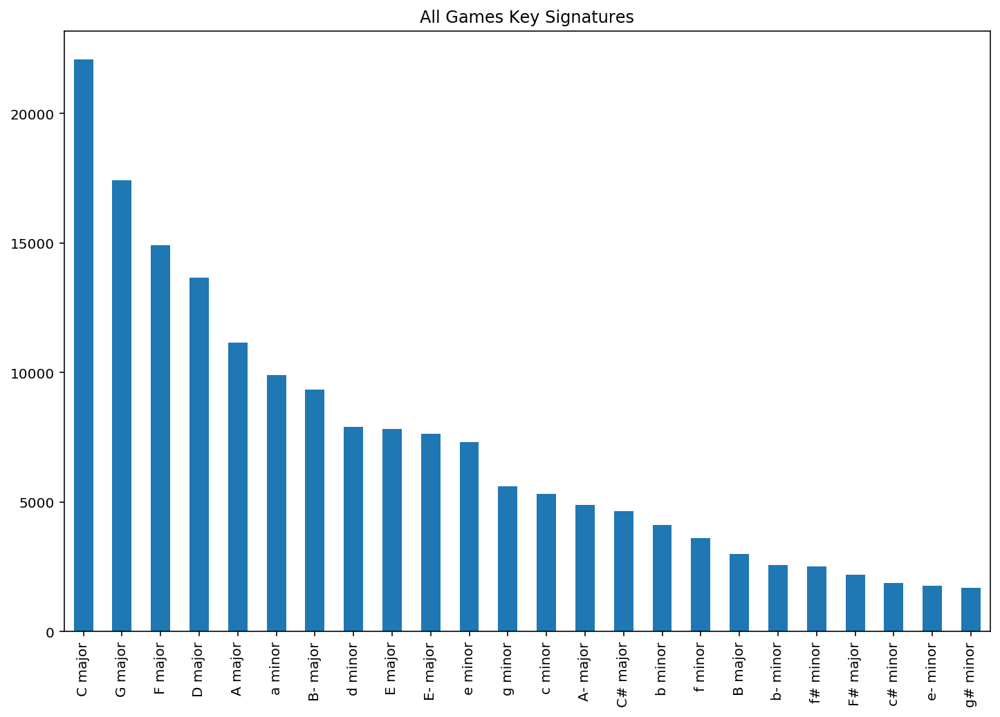

In [671]:
#!XL
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
fig, axes = plt.subplots(nrows=1, ncols = 1, figsize=(12, 8))
fig.subplots_adjust(hspace=0.4, wspace=0.3)
title = "All Games Key Signatures"
sonic_df_train["key_signature"].value_counts().plot(kind='bar', title = title)

In [19]:
#!XL
sonic_df['harmonic_reduction'] = [x.replace("'", "").replace(" ", "").strip('[]').split(',') for x in sonic_df['harmonic_reduction']]

In [827]:
#!XL
sonic_df.head()

,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
0,423.mid,key,A major,"[vii43, IV64, iii6, I53, I53, I53, I53, I53]",107,A,%3sharps
1,1413.mid,key,A- major,"[V, iii42, #iii42, iii64, #vii42, #iii43, iii4...",100,Ab,%4flats
2,6923.mid,key,c minor,"[i53, v7, III, v43, i53, v7, III, v43]",120,Eb,%3flats
3,6270.mid,key,e minor,"[i, i, iv, iv, v, v, iv7, ii65]",225,E,%4sharps
4,8599.mid,key,F# major,"[v, --vii64, -i, -iv, v, --vii64, -i, v42]",133,F#,%6sharps


In [22]:
#!XL
sonic_df_train['harmonic_reduction'] = [x.replace("'", "").replace(" ", "").strip('[]').split(',') for x in sonic_df_train['harmonic_reduction']]

In [828]:
#!XL
sonic_df_train.head()

,Unnamed: 0,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
0,0,143226.mid,key,C major,"[iii6, iii6, I, I, IV, IV6, ii, iv, I64, I, I,...",114,C,%0sharps
1,1,136836.mid,key,F major,"[-, -, -, -, -, ii42, iii, I, vi65, iii, vii, ...",175,F,%1flats
2,2,38125.mid,key,F major,"[I, IV64, I6, i, V64, IV64, i, -, -, -, -, -, ...",130,C,%0sharps
3,3,181164.mid,key,b- minor,"[-, -, -, -, -, -, -, -, -, -, -, -, -, -, ##v...",116,Ab,%4flats
4,4,57858.mid,key,G major,"[V7, I64, VI43, ii53, II7, vii7, I53, V65, vi4...",76,G,%1sharps


In [708]:
#!XL
sonic_df_train.to_csv('sonic_df_train_QKperc.csv', sep=';')

In [24]:
#!XL
del model

NameError: name 'model' is not defined

In [25]:
#!XL
#!XL
import gensim, logging
# logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)
# del model
model = gensim.models.Word2Vec(pd.concat([sonic_df["harmonic_reduction"], sonic_df_train["harmonic_reduction"]]), min_count=2, window=4)

In [26]:
#!XL
model

In [27]:
#!XL
def get_related_chords(token, topn=3):
    print("Similar chords with " + token)
    for word, similarity in model.wv.most_similar(positive=[token], topn=topn):
        print (word, round(similarity, 3))

def get_chord_similarity(chordA, chordB):
    print("Similarity between {0} and {1}: {2}".format(
        chordA, chordB, model.wv.similarity(chordA, chordB)))
    
print("List of chords found:")
print(model.wv.vocab.keys())
print("Number of chords considered by model: {0}".format(len(model.wv.vocab)))

get_related_chords('I')
get_related_chords('iv')
get_related_chords('V')

# The first one should be smaller since "i" and "ii" chord doesn't share notes,
# different from "IV" and "vi" which share 2 notes.
get_chord_similarity("I", "ii") 
get_chord_similarity("IV", "vi")

# This one should be bigger because they are "enharmonic".
get_chord_similarity("-i", "vii")

List of chords found:
dict_keys(['vii43', 'IV64', 'iii6', 'I53', 'V', 'iii42', '#iii42', 'iii64', '#vii42', '#iii43', 'iii43', 'V53', 'i53', 'v7', 'III', 'v43', 'i', 'iv', 'v', 'iv7', 'ii65', '--vii64', '-i', '-iv', 'v42', 'I6', '-VII6', 'IV53', 'V64', '#iii', 'v53', 'i64', 'III6', '-VII64', 'iv42', '-VII', 'ii', '--vii', 'iii', '-vii', 'i65', 'vi', 'IV', 'ii42', 'V6', 'vii', 'I', 'III53', '-VII53', 'iii65', 'i43', 'I43', 'I64', 'II53', 'vii65', '#vi', '-VI', 'vi43', '#iii7', 'V7', 'ii7', '#ii', 'IV43', 'V43', 'vii53', 'iv64', '--iii6', 'vi7', '-iv64', 'ii53', '-iii', 'V65', '#v65', 'i7', '#vi43', 'IV7', 'I65', 'vi53', 'III42', 'ii43', '##iii42', '##iii', '-vi', '--vi', '--vi6', 'iii7', 'II64', 'VI', '#vi42', '-iv6', '#iii65', '#vii65', '#vi7', 'IV42', '--iii', '-i6', '#v', '#ii42', 'vii6', 'i6', 'vi42', 'iii53', 'IV6', '-ii7', 'ii6', '-ii', 'i42', 'III7', '-i64', 'vi6', 'II6', '#iv65', 'vi64', 'V42', '-II6', 'I42', '-IV', '--VI53', 'iv43', '-VI53', '-II53', '-VI7', 'iv53', '#iv6', '#i

In [28]:
#!XL
import numpy as np
def vectorize_harmony(model, harmonic_reduction):
    # Gets the model vector values for each chord from the reduction.
    word_vecs = []
    for word in harmonic_reduction:
        try:
            vec = model[word]
            word_vecs.append(vec)
        except KeyError:
            # Ignore, if the word doesn't exist in the vocabulary
            pass
    
    # Assuming that document vector is the mean of all the word vectors.
    return np.mean(word_vecs, axis=0)

def cosine_similarity(vecA, vecB):
    # Find the similarity between two vectors based on the dot product.
    csim = np.dot(vecA, vecB) / (np.linalg.norm(vecA) * np.linalg.norm(vecB))
    if np.isnan(np.sum(csim)):
        return 0
    
    return csim

In [29]:
#!XL
vectorize_harmony(model, sonic_df["harmonic_reduction"][0:1].values[0])
# sonic_df["harmonic_reduction"][0:1].values[0]

/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


array([-0.6051477 , -0.2237111 , -0.02951586,  0.5999691 , -0.42516539,
        0.08446342, -0.00470278, -0.45330623, -0.0389249 ,  0.2541384 ,
       -0.3492731 ,  1.6976275 ,  1.2165464 ,  0.67873424, -0.27594197,
        0.06744915, -0.58572215,  0.6728834 ,  0.51616794,  0.08279039,
       -0.3892532 ,  1.137463  ,  0.2072683 ,  0.08346185, -0.04145067,
       -0.10389739,  0.32510304, -0.5540768 ,  0.27413443,  0.7580488 ,
       -0.0952682 , -0.03622723, -1.119405  ,  0.15681991,  0.5325295 ,
       -0.4480401 , -0.15207349,  0.47648266,  0.39819008,  0.65854883,
       -0.5629211 , -0.01533528, -0.539312  ,  0.26547086,  0.03508874,
       -0.00498778, -0.04819586,  0.32815117,  0.5244615 , -0.12054171,
        0.6917026 , -0.2014063 ,  0.18099043, -0.51134723,  0.47488594,
        0.24077778, -0.67922926,  0.2102156 , -0.23827925,  0.5438138 ,
        0.62829626,  0.14565966, -0.35995013,  1.1128097 ,  0.05021702,
        0.21039878, -0.35780308, -0.02720419, -1.0394835 , -0.03

In [30]:
#!XL
a_ = vectorize_harmony(model, sonic_df["harmonic_reduction"][0:1].values[0])
b_ = vectorize_harmony(model, sonic_df["harmonic_reduction"][1:2].values[0])
cosine_similarity(a_, b_)

/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


0.1258306

In [31]:
#!XL
sonic_df_train.loc[(sonic_df_train.Q==120) & (sonic_df_train.K=='A')]

,Unnamed: 0,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%
106,106,68686.mid,key,A major,"[V7, I53, I64, I64, V53, I53, IV, I53, I53, v,...",120,A,%3sharps
237,237,97515.mid,key,A major,"[I53, V, I53, vi7, ii7, ii65, IV42, ii, I53, v...",120,A,%3sharps
260,260,125624.mid,key,A major,"[iv, iv, iii, iii, iii, iii, i, i, -, -, i, i,...",120,A,%3sharps
363,363,161579.mid,key,b minor,"[i64, i, -iv7, -VII, i7, i7, #vi65, #vi65, i7,...",120,A,%3sharps
406,406,132405.mid,key,B major,"[-v, ii42, IV64, IV53, IV53, -i, IV, -iv6, -i,...",120,A,%3sharps
...,...,...,...,...,...,...,...,...
172414,172414,9799.mid,key,D major,"[v, v, iii42, iii42, I, vi42, v, ii, iii42, ii...",120,A,%3sharps
172472,172472,45136.mid,key,A major,"[v7, v7, ii42, I53, I53, I53, I64, v7, v7, v7,...",120,A,%3sharps
172584,172584,6793.mid,key,D major,"[-, -, -, -, -, -, -, -, -, -, I64, II64, I64,...",120,A,%3sharps
172771,172771,43741.mid,key,A major,"[IV7, IV7, I64, I64, I64, IV7, IV7, IV7, I64, ...",120,A,%3sharps


In [32]:
#!XL
def calculate_similarity_aux(df, df_train, model, threshold=0.5):
    out_df = df.copy()
    out_df['continue'] = ''
    out_df['sim_score'] = 0
#     all_names = df["midi_name"].values
    for index, row in tqdm(out_df.iterrows()):
        name = row["midi_name"]
        source_harmo = row["harmonic_reduction"]
        source_vec = vectorize_harmony(model, source_harmo)    
        results = []
        key_signature = row['key_signature']
        Q = row["Q"]
        K = row["K"]
        perc = row["%"]
        results.append({
                    'score' : 0,
                    'name' : 'no'
                })
        for index2, row2 in df_train.loc[(df_train['key_signature']==key_signature) & (df_train.Q==Q) & (df_train.K==K) & (df_train['%']==perc)].iterrows():
            n = row2["midi_name"]
            if name != n:
                target_harmo = row2["harmonic_reduction"]
                if (len(target_harmo) == 0):
                    continue

                target_vec = vectorize_harmony(model, target_harmo)       
                sim_score = cosine_similarity(source_vec, target_vec)
    #             print(sim_score)
                if sim_score > threshold:
                    results.append({
                        'score' : sim_score,
                        'name' : n
                    })
#                 if sim_score >= 0.98:
#                     break

        # Sort results by score in desc order
        results.sort(key=lambda k : k['score'] , reverse=True)
#         print(len(results))
        if results[0]['name'] == 'no':
            out_df.loc[index, 'continue'] = name
        else:
#             print(results[0]['name'])
            out_df.loc[index, ['continue', 'sim_score']] = [results[0]['name'], results[0]['score']]
            
    return out_df

In [894]:
#!XL
out_df_train = calculate_similarity_aux(sonic_df, sonic_df_train, model, threshold=0.6)
out_df_train.to_csv('out_df_train.csv', sep=';')
out_df_train.loc[out_df_train.sim_score>=0.6]

0it [00:00, ?it/s]/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys
10200it [11:23, 14.93it/s]


,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%,continue,sim_score
0,423.mid,key,A major,"[vii43, IV64, iii6, I53, I53, I53, I53, I53]",107,A,%3sharps,75142.mid,0.943058
1,1413.mid,key,A- major,"[V, iii42, #iii42, iii64, #vii42, #iii43, iii4...",100,Ab,%4flats,152747.mid,0.874396
2,6923.mid,key,c minor,"[i53, v7, III, v43, i53, v7, III, v43]",120,Eb,%3flats,179394.mid,0.812315
6,4853.mid,key,D major,"[I53, I53, I53, I53, I53, V, I53, V64]",117,D,%2sharps,70228.mid,0.977593
7,5152.mid,key,A- major,"[iii6, #iii, v53, #iii, #iii, v53, #iii, iii6]",82,Db,%5flats,78597.mid,0.756911
...,...,...,...,...,...,...,...,...,...
10192,163.mid,key,A major,"[vi, vi, I53, I, I53, I, I53, I]",120,A,%3sharps,54917.mid,0.923861
10193,2590.mid,key,B- major,"[#i, V42, iii, V, V53, iii6, #vi42, IV]",109,Bb,%2flats,157054.mid,0.686735
10196,4446.mid,key,e minor,"[III7, ii65, III7, i, III53, III7, III7, i]",86,D,%2sharps,170965.mid,0.612760
10198,1838.mid,key,B major,"[ii, -i, -iv, -iv, IV53, -i, -iv, -iv]",120,B,%5sharps,1914.mid,0.980443


In [884]:
#!XL
out_df_train.loc[out_df_train.sim_score>=0.7]

,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%,continue,sim_score
0,423.mid,key,A major,"[vii43, IV64, iii6, I53, I53, I53, I53, I53]",107,A,%3sharps,75142.mid,0.943058
1,1413.mid,key,A- major,"[V, iii42, #iii42, iii64, #vii42, #iii43, iii4...",100,Ab,%4flats,152747.mid,0.874396
2,6923.mid,key,c minor,"[i53, v7, III, v43, i53, v7, III, v43]",120,Eb,%3flats,179394.mid,0.812315
6,4853.mid,key,D major,"[I53, I53, I53, I53, I53, V, I53, V64]",117,D,%2sharps,70228.mid,0.977593
7,5152.mid,key,A- major,"[iii6, #iii, v53, #iii, #iii, v53, #iii, iii6]",82,Db,%5flats,78597.mid,0.756911
...,...,...,...,...,...,...,...,...,...
10187,8857.mid,key,g# minor,"[-vi, iii, -vi, iii, -vi, --vi, --vii, --vi]",120,F#,%6sharps,138890.mid,0.972268
10188,2259.mid,key,g# minor,"[--vi6, iv, iv65, --vi6, iv, vii7, -VI6, i]",109,B,%5sharps,26148.mid,0.806813
10190,9191.mid,key,e- minor,"[v, #v, #iv42, #iv, #v, v, v, v]",125,F#,%6sharps,178456.mid,0.787531
10192,163.mid,key,A major,"[vi, vi, I53, I, I53, I, I53, I]",120,A,%3sharps,54917.mid,0.923861


In [837]:
#!XL
header, bars = r_abc('trainset_abc_8/154270.abc')

In [840]:
#!XL
len(''.join(bars[0:2]).split('|'))

9

In [841]:
#!XL
header1, bars1 = r_abc('testset/abc/7184.abc')
header2, bars2 = r_abc('trainset_abc_8/154270.abc')
predicted_bars = bars1 + ''.join(bars2).split('|')[0:8]
result_abc_file = 'draft.abc'
result_mid_file = 'draft.mid'

with open(result_abc_file, 'w') as output_file:
    output_file.write('\n'.join(header1 + predicted_bars))
abc2midi(result_abc_file, result_mid_file)
    

/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:619: UserWarning: The following variables cannot be serialized: output_file
  warnings.warn(message)


In [842]:
#!XL
player2('draft.mid', '')

In [36]:
#!XL
def player2(path, p2): 
    wav_file = 'tmp/'+path.split('.')[0]+'.wav'
    midi2wav(p2+path, wav_file)
    return Audio(wav_file)

player2('6923.mid', 'testset_midi/')

In [37]:
#!XL
player2('179394.mid', 'trainset_midi/')

In [895]:
#!XL

z = []

def r_abc(path):
    header = []
    bars = []
    is_header = True
    with open(path, 'r') as input_file:
        for line in input_file:
            line = line.strip()
            if is_header and (not line or line.startswith('%') or (line[0] in ascii_letters and line[1] == ':')):
                header.append(line)
            else:
                is_header = False
                bars.append(line)
    return header, bars

for index, row in tqdm(out_df_train.iterrows()):
    
    if row['sim_score']>=0.6:
    
        header1, bars1 = r_abc('testset/abc/'+row["midi_name"].split('.')[0]+'.abc')
        header2, bars2 = r_abc('trainset_abc_8/'+row["continue"].split('.')[0]+'.abc')


        # a sophisticated machine learning algorithm that predicts next 8 bars of music comes here
#         predicted_bars = bars1 + bars2
        predicted_bars = bars1 + ''.join(bars2).split('|')[0:8]
        assert len(predicted_bars) == 16, f'Prediction must be of 16 bars, but got {len(predicted_bars)} bars'
        assert predicted_bars[:8] == bars1, 'First 8 bars of the result must be the same as in query'

        # prepare the resulting files
        result_abc_file = 'predict_abc_pairs/'+row["midi_name"].split('.')[0]+'.abc'
        result_mid_file = 'predict_midi_pairs/'+row["midi_name"].split('.')[0]+'.mid'

        # save to .abc
        with open(result_abc_file, 'w') as output_file:
            output_file.write('\n'.join(header1 + predicted_bars))

        # convert .abc to .mid
    #     print(result_abc_file, result_mid_file)
    #     break
        abc2midi(result_abc_file, result_mid_file)
        z.append(result_mid_file)
    else:
    
        header, bars = r_abc('testset/abc/'+row["midi_name"].split('.')[0]+'.abc')

        # a sophisticated machine learning algorithm that predicts next 8 bars of music comes here
        predicted_bars = bars + bars
        assert len(predicted_bars) == 16, f'Prediction must be of 16 bars, but got {len(predicted_bars)} bars'
        assert predicted_bars[:8] == bars, 'First 8 bars of the result must be the same as in query'

        # prepare the resulting files
        result_abc_file = 'predict_abc_pairs/'+row["midi_name"].split('.')[0]+'.abc'
        result_mid_file = 'predict_midi_pairs/'+row["midi_name"].split('.')[0]+'.mid'

        # save to .abc
        with open(result_abc_file, 'w') as output_file:
            output_file.write('\n'.join(header + predicted_bars))

        # convert .abc to .mid
    #     print(result_abc_file, result_mid_file)
    #     break
        abc2midi(result_abc_file, result_mid_file)
        z.append(result_mid_file)

10200it [08:58, 18.94it/s]
/kernel/lib/python3.7/site-packages/ml_kernel/kernel.py:619: UserWarning: The following variables cannot be serialized: output_file
  warnings.warn(message)


In [846]:
#!XL
z[15]

'predict_midi_pairs/2769.mid'

In [899]:
#!XL
out_df_train.loc[out_df_train.sim_score>=0.6][90:100]

,midi_name,game_name,key_signature,harmonic_reduction,Q,K,%,continue,sim_score
124,7082.mid,key,c minor,"[i, i, i, III7, i, i, v, i]",131,Eb,%3flats,90077.mid,0.641110
125,3744.mid,key,a minor,"[i64, i53, III, -VII6, -VII6, -VI64, III53, II...",120,C,%0sharps,34010.mid,0.934045
126,7032.mid,key,c minor,"[i42, III, i, iii43, #v42, III53, v42, i]",77,Eb,%3flats,175502.mid,0.753371
127,5950.mid,key,E major,"[i, ii7, i, ii43, I53, IV, i, IV64, vi]",84,E,%4sharps,143430.mid,0.702880
130,6516.mid,key,c# minor,"[i7, -iii, i7, v42, i7, -iii, i7, v42]",88,E,%4sharps,17214.mid,0.651535
131,7372.mid,key,A- major,"[iii, iii, iii, iii, iii, iii, iii, iii]",98,Eb,%3flats,111951.mid,0.992947
132,7084.mid,key,c minor,"[i6, #vii, i65, #vi64, v53, #iv7, v7, v43]",110,Eb,%3flats,5476.mid,0.692778
133,2362.mid,key,B major,"[-iv, vi42, iv, -iv, i, iv, iv, -iv]",70,B,%5sharps,112467.mid,0.846767
134,7597.mid,key,c minor,"[iv, i, V53, V53, i53, i53, i7, vii]",120,Eb,%3flats,45500.mid,0.942973
135,1211.mid,key,b- minor,"[i, i, i, V, i, i, i, V]",138,Ab,%4flats,144779.mid,0.738420


In [902]:
#!XL
player2('7084.mid', 'predict_midi_pairs/')

In [878]:
#!XL
player2('7220.mid', 'testset_midi/')

In [850]:
#!XL
player2('164025.mid', 'trainset_midi/')

In [903]:
#!nirvana
yadc_submit_results --result-dir ./predict_midi_pairs --user pansf

[Step 1/2] Submitting audio files from ./predict_midi_pairs ...
[Step 2/2] Running estimation process ...

 100.0% [==================================================>]

Score of your submission: 0.240000
You can see the full leader board at https://datalens.yandex/k9w3qh5luixef


In [ ]:
#!XL
